The pendulum consists of a mass $m$ attached to a string of length $l$. Assuming no air resistance and small oscillations, the motion of the pendulum can be described using the Euler-Lagrange formalism.


The Lagrangian $L$ of a system is defined as the difference between the kinetic energy $T$ and the potential energy $V$:

$$
L = T - V
$$

For a simple pendulum, the kinetic energy $T$ is given by:

$$
T = \frac{1}{2} m l^2 \dot{\theta}^2
$$

where $\dot{\theta}$ is the angular velocity. The potential energy $V$, assuming the zero potential energy level is at the lowest point of the swing, is:

$$
V = mgl(1 - \cos{\theta})
$$

where $g$ is the acceleration due to gravity. Therefore, the Lagrangian $L$ becomes:

$$
L = \frac{1}{2} m l^2 \dot{\theta}^2 - mgl(1 - \cos{\theta})
$$

The Euler-Lagrange equation is given by:

$$
\frac{d}{dt} \left( \frac{\partial L}{\partial \dot{\theta}} \right) - \frac{\partial L}{\partial \theta} = 0
$$

Applying this to the Lagrangian of the pendulum, we obtain the equation of motion:

$$
\ddot{\theta} + \frac{g}{l} \sin{\theta} = 0
$$

This is a second-order differential equation describing the angular acceleration $\ddot{\theta}$ of the pendulum. In this simulation, we solve this equation numerically to analyze the motion of the pendulum under different initial conditions.


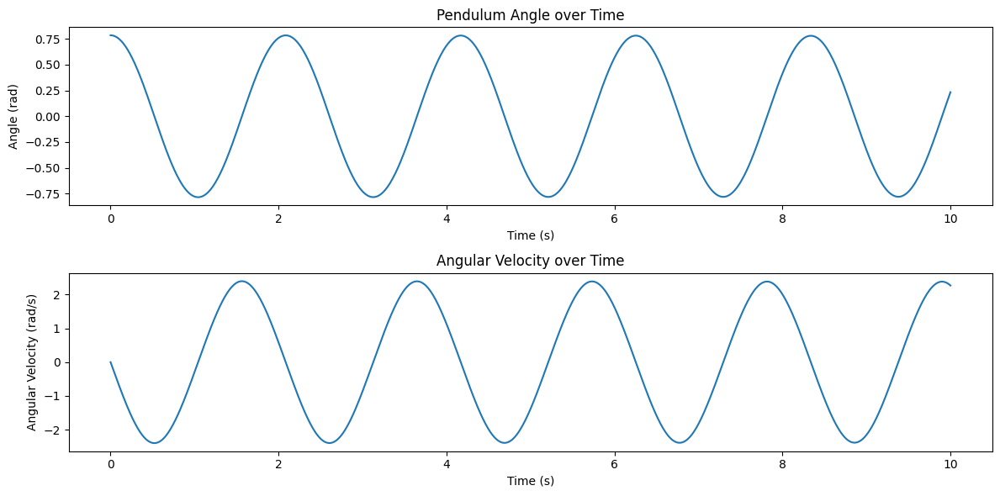

In [6]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.integrate import solve_ivp

# Constants
g = 9.81  # acceleration due to gravity (m/s^2)
l = 1.0   # length of the pendulum (meters)

# Equation of motion for the pendulum (derived from Euler-Lagrange equation)
def pendulum_equation(t, y):
    theta, omega = y
    dtheta_dt = omega
    domega_dt = -(g / l) * np.sin(theta)
    return [dtheta_dt, domega_dt]

# Initial conditions: [initial angle (radians), initial angular velocity (rad/s)]
initial_conditions = [np.pi / 4, 0]

# Time span for the simulation (seconds)
t_span = (0, 10)
t_eval = np.linspace(t_span[0], t_span[1], 1000)

# Numerically solve the equation of motion
solution = solve_ivp(pendulum_equation, t_span, initial_conditions, t_eval=t_eval)

# Extract the solution
theta = solution.y[0]
omega = solution.y[1]
time = solution.t

# Plotting the results
plt.figure(figsize=(12, 6))

# Theta (angle) over time
plt.subplot(2, 1, 1)
plt.plot(time, theta)
plt.title('Pendulum Angle over Time')
plt.xlabel('Time (s)')
plt.ylabel('Angle (rad)')

# Omega (angular velocity) over time
plt.subplot(2, 1, 2)
plt.plot(time, omega)
plt.title('Angular Velocity over Time')
plt.xlabel('Time (s)')
plt.ylabel('Angular Velocity (rad/s)')

plt.tight_layout()
plt.show()

Animation size has reached 20977992 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


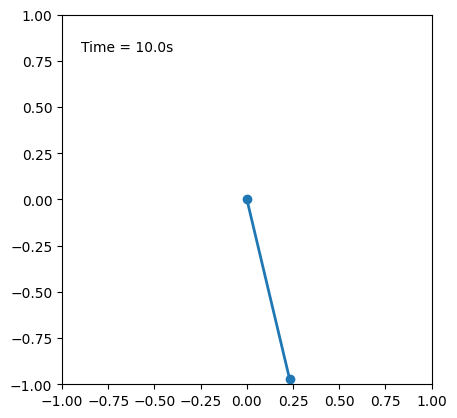

In [7]:
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

# Constants for the pendulum
length = 1.0  # length of the pendulum (meters)

# Create figure and axis for the animation
fig, ax = plt.subplots()
ax.set_xlim(-length, length)
ax.set_ylim(-length, length)
ax.set_aspect('equal', 'box')

# Elements of the pendulum in the plot: line and bob
line, = ax.plot([], [], 'o-', lw=2)
time_template = 'Time = %.1fs'
time_text = ax.text(0.05, 0.9, '', transform=ax.transAxes)

# Initialization function: plot the background of each frame
def init():
    line.set_data([], [])
    time_text.set_text('')
    return line, time_text

# Animation function: this is called sequentially
def animate(i):
    x = length * np.sin(theta[i])
    y = -length * np.cos(theta[i])

    line.set_data([0, x], [0, y])
    time_text.set_text(time_template % time[i])
    return line, time_text

# Call the animator
ani = FuncAnimation(fig, animate, frames=len(time), init_func=init, blit=True, interval=20)

# Display the animation
HTML(ani.to_jshtml())